# <span style="font-family:Avenir; color:blue; font-size:2em;">Grid Search Algorithms</span>

## <font color='navy'> Motivation
<font color='crimson'>Why we need "grid search" algorithms?</font>

We may consider the fact that almost all models in Machine Learning require specific hyperparameters:

<figure>
<center>
<img src='https://drive.google.com/uc?id=1ZJkCH0O7fhHwdQFPw1tqsvpXpnakHEHC'
width='500px' />
<figcaption>Example</figcaption></center>
</figure>

<font color='red' size=4pt>**CRITICAL THINKING**: Why aren't we testing all possible choices/values for the hyperparameters?</font>

<font color='red' size=4pt> **CRITICAL THINKING**: Why not just use gradient descent to determine the best choice of hyperparameters? </font>

<font color='blue' size=4pt>IMPORTANT: We may rarely be able to compute gradients of the prediction error with respect to the *hyper*parameters.</font>

Also, in general, we deal with a problem of non-convex optimization and just finding a local minima is not good enough; also cannot easily compute the direction (gradient) for improving the hyperparameters that we try to optimize.

<font color='green' size = 4pt>**SOLUTION**:



*   Subdivide the ranges of hyperparameters in grids (if they are numerical, eaqually spaced values)
*   Initialize the hyperparameters with a random choice
*   Evaluate the prediction error with this choice
*   Update the hyperparameters with a *procedure* that includes *good heuristics*
*   Test the new choice
*   Repeat the previously two steps until there is no more distinguishable progress relative to a tolerance value. </font>




We can use algorithms that do not require the gradient of the objective function in order to estimate the value for the *hyperparameters* and thus complete the *model selection* process.

A *Grid Search* will involve subdividing the range of the hyperparameters by using small increments and then the grid search algorithm is choosing the value of the parameters from a finite set of choices within the range.

The simplest *grid search algorithm* is an exhaustive search, namely loop through all the candidates and pick the one that is the *best* according to predefined criteria, such as minimizing the k-fold cross-validated loss or maximizing the accuracy, etc.

<span style="font-family:Calibri; color:DodgerBlue; font-size:14pt;">Important:</span> In practice we cannot search all the points in a multi-dimensional grid, it is computationally too expensive. We need a strategy that efficiently approximates the solution.

**Example**: Assume that we want to determine the best tree depth *and* the best leaf size for a classification tree. The following image color-codes the values of the cost function based on the grid values.

<figure>
<center>
<img src='https://drive.google.com/uc?id=1EVr1hhK44KMTgke8U8feyfSm2mtA27uy'
width='500px' />
<figcaption>Example of a Grid</figcaption></center>
</figure>

<span style="font-family:Calibri; color:DeepPink; font-size:14pt;">Critical Thinking Question:</span> If we compute the cost function at some random point on the grid how do we know in what direction we can continue to search for improving (lowering) the value of the cost function?

<figure>
<center>
<img src='https://drive.google.com/uc?id=1jtywm9tz-eZWevgGo1RWQ9PM15EOnb3K'
width='500px' />
<figcaption>Example of a Grid</figcaption></center>
</figure>



## <font color='navy'> Genetic Algorithms

<figure>
<center>
<img src='https://drive.google.com/uc?id=1oc1UMJRcwAOAF2vexna7hlTmaMlNwMh_'
width='400px' />
<figcaption>Genetic Algorithm</figcaption></center>
</figure>

### **Evaluation**

We compute the value of the ouput at each individual form the population and we ranked the individuals.

### **Selection**

In order to create a parent we draw a random subset from the population and pick the most "fit" individual. Once we obtain two parents we can applying the *crossover* and *mutation* procedures for generating children.

### **Crossover**

Typically we implement a two-point crossover. If the grid is 2-D we consider a crossover procedure illustrated below:

<figure>
<center>
<img src='https://drive.google.com/uc?id=1PFG_GnavxIdJeCe-iDTlWv-RluHxHepo'
width='400px' />
<figcaption>Two-point crossover in 2-D</figcaption></center>
</figure>

In 3-D a two-point crossover can be implemented as follows:

<figure>
<center>
<img src='https://drive.google.com/uc?id=1GmazeR1zWMVlNPgG4q73rWoFErobf8bF'
width='400px' />
<figcaption>Two-point crossover in 3-D</figcaption></center>
</figure>


### **Mutation**

We implement the mutation as a perturbation with values sampled from a random normal variable of mean 0 and standard deviation equal to the desired "mutation scale."

Example for the mutation function:

```Python
def mutate(child, mutation_rate, mutation_scale):
    "May mutate a child using Gaussian convolution"
    if mutation_rate >= random.uniform(0, 1):
        size = child.shape[0]
        mutation_value = np.random.normal(0, mutation_scale, size)
        child = child + mutation_value
    return child
```

### **Example of Visualization**

<figure>
<center>
<img src='https://drive.google.com/uc?id=1faLEaop7OFfeiw-coovR6vt7nY6qBuS6'
width='1000px' />
<figcaption>Two-point crossover in 3-D</figcaption></center>
</figure>




<font size=4pt> References:

*   http://cobweb.cs.uga.edu/~potter/CompIntell/ga_tutorial.pdf

*   https://www.scottcondron.com/jupyter/optimisation/visualisation/2020/07/20/interactive-genetic-algorithm-dashboard-from-scratch-in-python.html

*   https://mitpress.mit.edu/9780262631853/an-introduction-to-genetic-algorithms/


Fun video to watch:

https://www.youtube.com/watch?v=FKbarpAlBkw





## <font color='navy' size=6pt> Swarm Algorithms - Particle Swarm Optimization</font>

Main Idea: consider a collection of particles that move around the search space influenced by their own best past location and the best past location of the whole swarm or a close neighbor.

<figure>
<center>
<img src='https://drive.google.com/uc?id=1dZibCB20kaKcqpQQ2v2JCLERzXTlWNuO'
width='500px' />
<figcaption>Example of a Function by Arrow Diagram</figcaption></center>
</figure>


$$\large v_i (t+1)=w\cdot v_i (t)+c_1⋅\chi⋅(p_i^{\text{best}} (t)−p_i (t))+c_2⋅\chi⋅(p^{\text{gbest}} (t)−p_i (t))$$

where $$\large \chi \sim \text{Unif}(0,1)$$ and $c_1$ and $c_2$ are constants.

The particle positions get updated: $$\large p_{i} (t+1)=p_i  (t)+v_i (t)$$

**Heuristics**

  - The number of particles should be low, around 20-40

  - The speed a particle can move (maximum change in its position per iteration) should be bounded, such as to a percentage of the size of the domain.

  - The learning factors (biases towards global and personal best positions) should be between 0 and 4, typically 2.

  - A local bias (local neighborhood) factor can be introduced where neighbors are determined based on Euclidean distance between particle positions.

  - Particles may leave the boundary of the problem space and may be penalized, be reflected back into the domain or biased to return back toward a position in the problem domain. Alternatively, a wrapping strategy may be used at the edge of the domain creating a loop, torrid or related geometrical structures at the chosen dimensionality.

An inertia or momentum coefficient can be introduced to limit the change in velocity.




In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import numpy as np
import pandas as pd
from math import gamma
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objs as go

## <font color='navy'> Example with Particle Swarm Optimization

In [2]:
# Example Objective function - Himmelblau function
def obj_function(x):
    f = (x[0]**2 + x[1] - 11)**2 + (x[0] + x[1]**2 - 7)**2
    return f

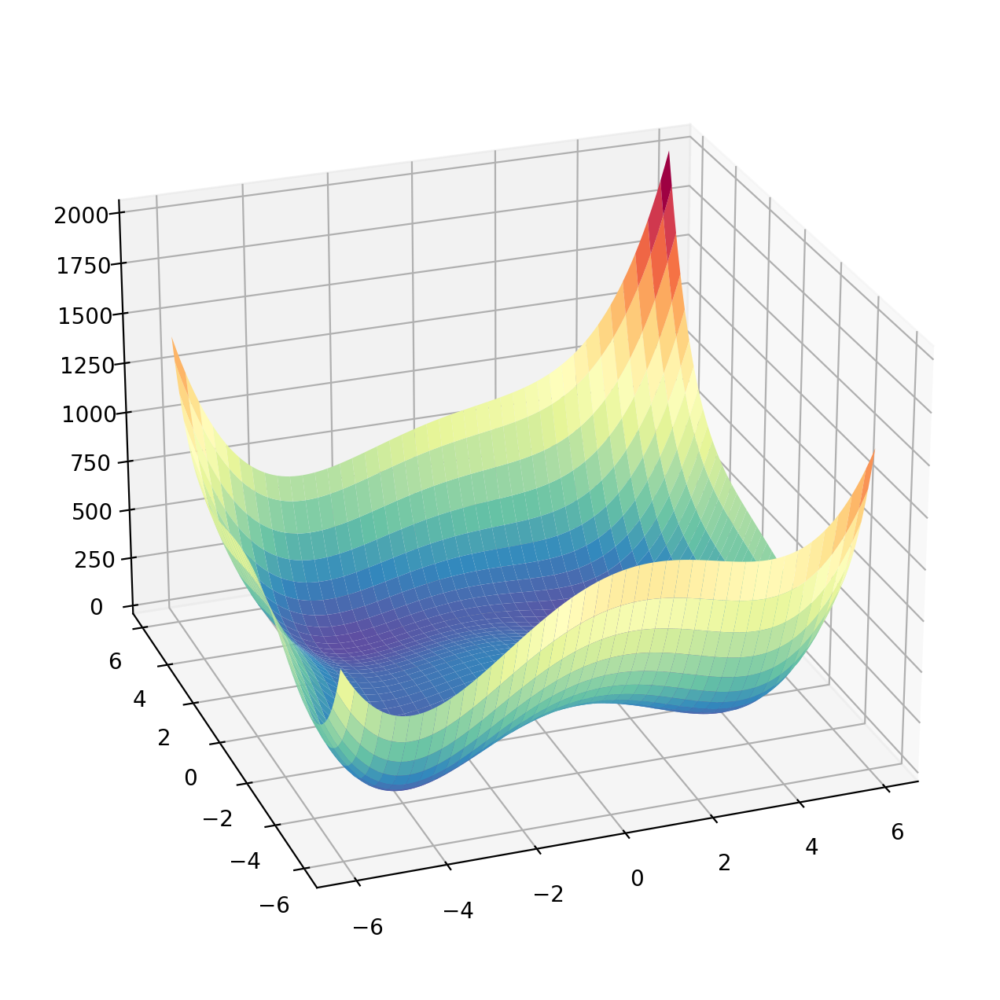

In [13]:
# define range for input
r_min, r_max = -6.0, 6.0
# sample input range uniformly at 0.1 increments
xaxis = np.arange(r_min, r_max, 0.1)
yaxis = np.arange(r_min, r_max, 0.1)
# create a mesh from the axis
X = np.meshgrid(xaxis, yaxis)
# compute targets
results = obj_function(X)
# create a surface plot with the jet color scheme
figure = plt.figure(figsize=(10,8))
axis = figure.add_subplot(projection='3d')
axis.plot_surface(X[0], X[1], results, cmap='Spectral_r')
axis.view_init(25,250)
# show the plot
plt.show()

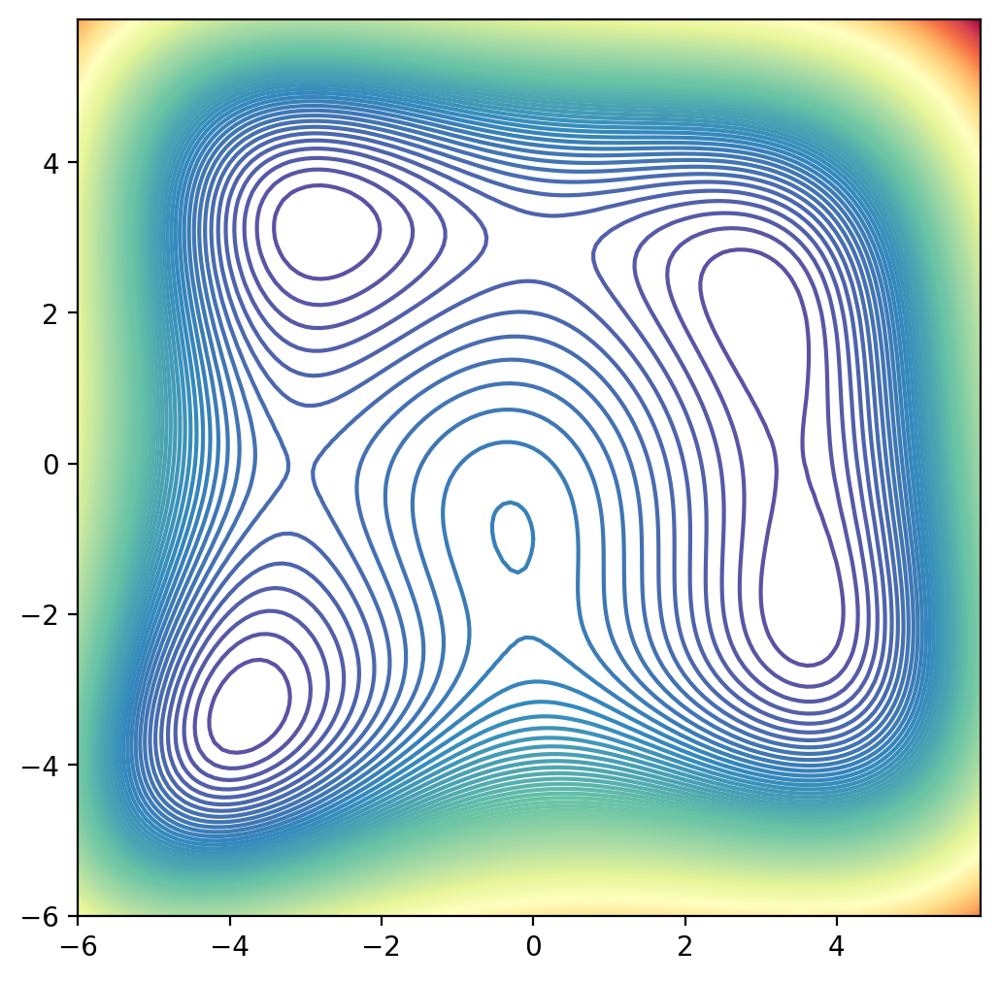

In [7]:
figure = plt.figure(figsize=(6,6))
plt.contour(X[0], X[1], results, 200, alpha=1.0, cmap='Spectral_r')
plt.show()

In [15]:
fig = go.Figure(data=[go.Surface(z=results, x=X[0], y=X[1],colorscale='Jet')])
fig.update_layout(title='Himmelblau Surface', autosize=True,
        scene = {
            "xaxis": {"nticks": 20},
            "zaxis": {"nticks": 4},
            'camera_eye': {"x": 0, "y": -1, "z": 0.5},
            "aspectratio": {"x": 1, "y": 1, "z": 0.75}})
fig.show()

## A Non-Convex Example - Griewank's Function



In [17]:
def obj_function(X):
    x1 = X[0]
    x2 = X[1]
    obj = 0.2 + x1**2 + x2**2 - 0.1*np.cos(6.0*3.1415*x1) - 0.1*np.cos(6.0*3.1415*x2)
    return obj

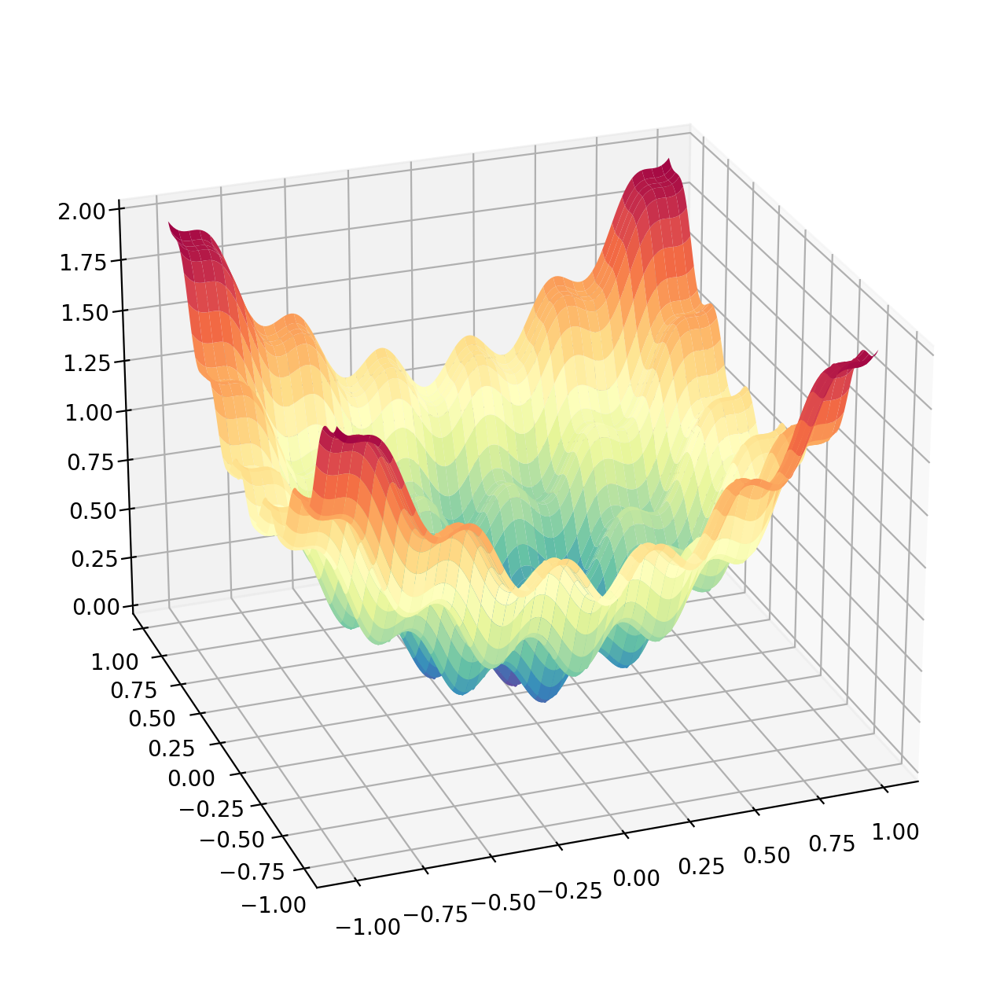

In [20]:
# define range for input
r_min, r_max = -1.0, 1.0
# sample input range uniformly at 0.1 increments
xaxis = np.arange(r_min, r_max, 0.01)
yaxis = np.arange(r_min, r_max, 0.01)
# create a mesh from the axis
X = np.meshgrid(xaxis, yaxis)
# compute targets
results = obj_function(X)
# create a surface plot with the jet color scheme
figure = plt.figure(figsize=(10,8))
axis = figure.add_subplot(projection='3d')
axis.plot_surface(X[0], X[1], results, cmap='Spectral_r')
axis.view_init(25,250)
# show the plot
plt.show()

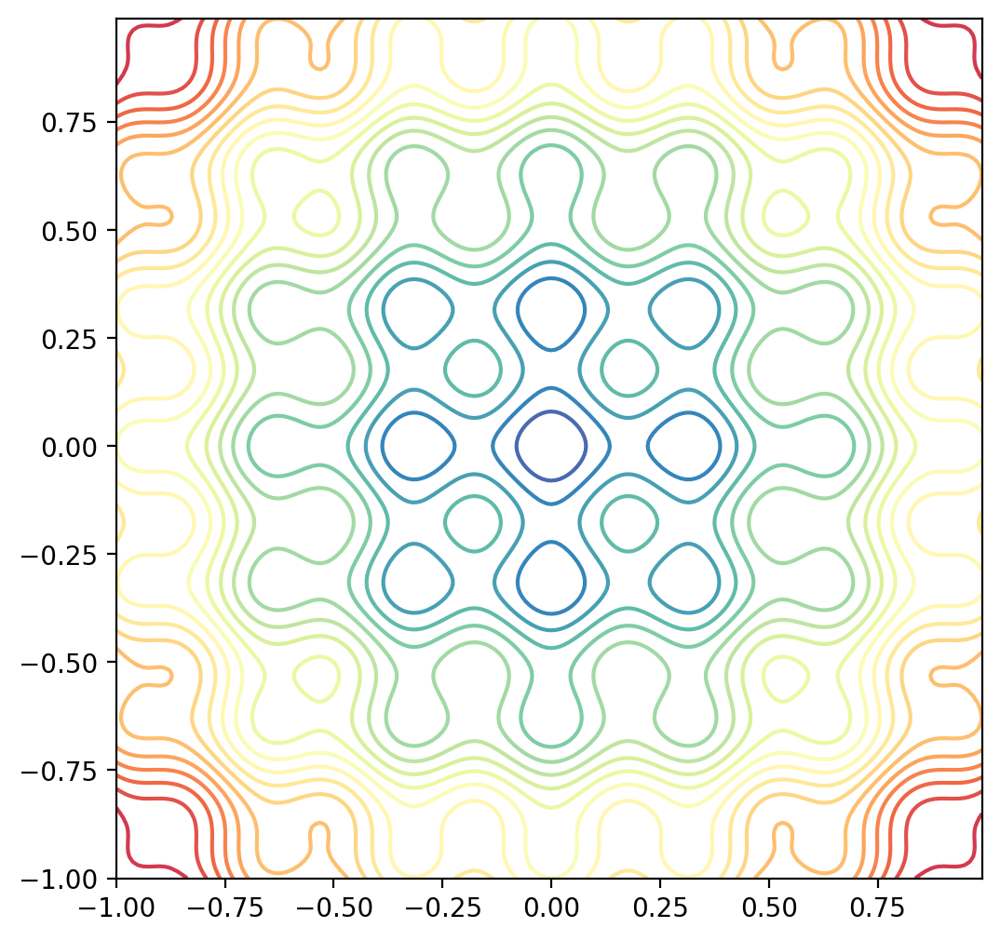

In [22]:
figure = plt.figure(figsize=(6,6))
plt.contour(X[0], X[1], results, 20, alpha=1.0, cmap='Spectral_r')
plt.show()

Text(0, 0.5, 'x2')

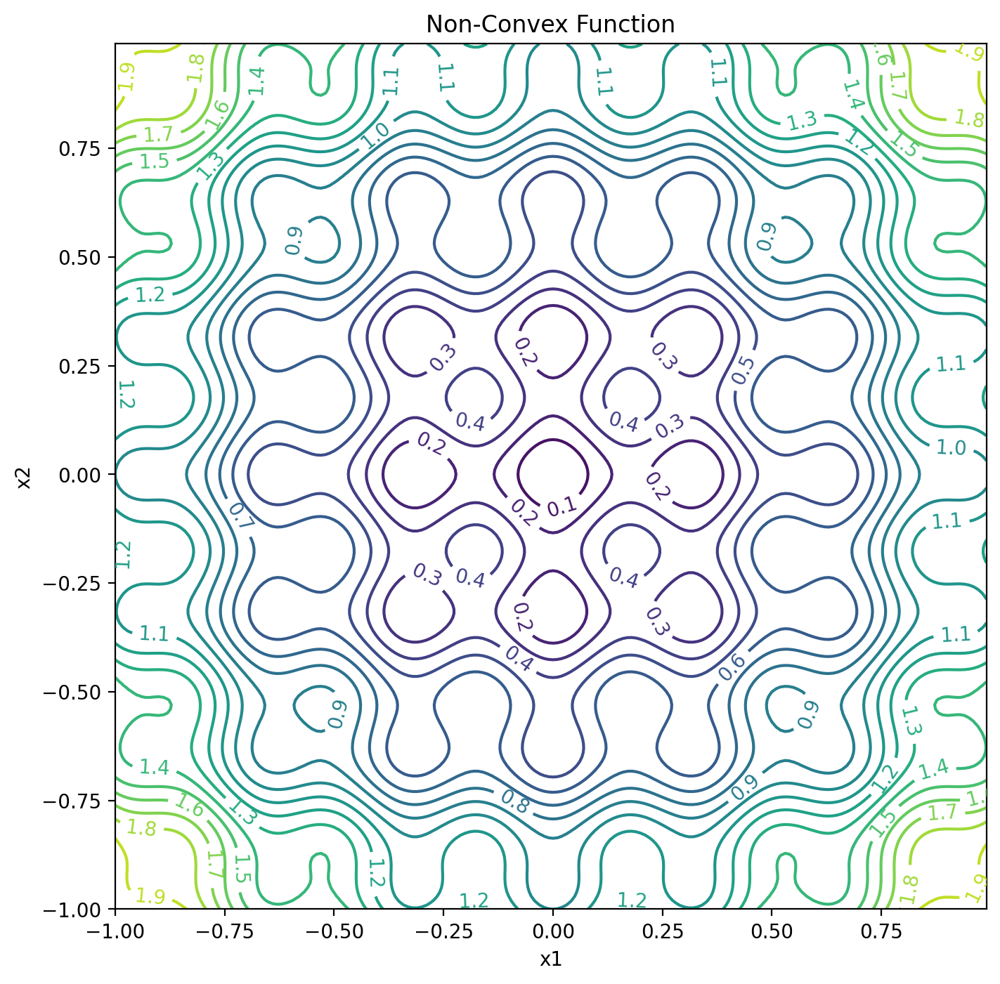

In [23]:
# Create a contour plot
plt.figure(figsize=(8,8))
# Specify contour lines
#lines = range(2,52,2)
# Plot contours
CS = plt.contour(X[0], X[1], results,20)#,lines)
# Label contours
plt.clabel(CS, inline=1, fontsize=10)
# Add some text to the plot
plt.title('Non-Convex Function')
plt.xlabel('x1')
plt.ylabel('x2')

In [24]:
fig = go.Figure(data=[go.Surface(z=results, x=X[0], y=X[1],colorscale='Jet')])
fig.update_layout(title='Non-Convex Surface', autosize=True,
        scene = {
            "xaxis": {"nticks": 20},
            "zaxis": {"nticks": 4},
            'camera_eye': {"x": 0, "y": -1, "z": 0.5},
            "aspectratio": {"x": 1, "y": 1, "z": 0.75}})
fig.show()

## Implementation Idea

Create a data structure (e.g., Python dictionary) that, for each particle, records the position, velocity and the particle's best position from the start.

In [8]:
# PSO algorithm

def particle_swarm_optimization(num_dimensions, num_particles, max_iter,i_min=-10,i_max=10,bounds=None,w=0.5,c1=0.25,c2=0.75):
    # Initialize the particles
    # This creates a data structure such as a dictionary
    if bounds is None:
        particles = [({'position': [np.random.uniform(i_min, i_max) for _ in range(num_dimensions)],
                    'velocity': [np.random.uniform(-1, 1) for _ in range(num_dimensions)],
                    'pbest': float('inf'),
                    'pbest_position': None})
                    for _ in range(num_particles)]
    else:
        particles = [({'position': [np.random.uniform(bounds[i][0], bounds[i][1]) for i in range(num_dimensions)],
                    'velocity': [np.random.uniform(-1, 1) for _ in range(num_dimensions)],
                    'pbest': float('inf'),
                    'pbest_position': None})
                    for _ in range(num_particles)]

    # Initialize global best
    gbest_value = float('inf')
    gbest_position = None

    for _ in range(max_iter):
        for particle in particles:
            position = particle['position']
            velocity = particle['velocity']

            # Calculate the current value
            current_value = obj_function(position)

            # Update personal best
            if current_value < particle['pbest']:
                particle['pbest'] = current_value
                particle['pbest_position'] = position.copy()

            # Update global best
            if current_value < gbest_value:
                gbest_value = current_value
                gbest_position = position.copy()

            # Update particle's velocity and position
            for i in range(num_dimensions):
                r1, r2 = np.random.uniform(), np.random.uniform()
                velocity[i] = w * velocity[i] + c1*r1 * (particle['pbest_position'][i] - position[i]) + c2*r2 * (gbest_position[i] - position[i])
                position[i] += velocity[i]
                # legalize the values to the provided bounds
                if bounds is not None:
                    position[i] = np.clip(position[i],bounds[i][0],bounds[i][1])

    return gbest_position, gbest_value



In [9]:
# Parameters
num_dimensions = 2
num_particles = 30
max_iter = 120
bounds = [(0, 10), (1, 4)]

# Run PSO
best_position, best_value = particle_swarm_optimization(num_dimensions, num_particles, max_iter,bounds=bounds)
print("Best Position:", best_position)
print("Best Value:", best_value)

Best Position: [3.0, 2.0]
Best Value: 0.0


### A 2D Animation

In [ ]:
!pip install -q pyswarms

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.1/104.1 kB 3.0 MB/s eta 0:00:00


In [ ]:
# Import modules
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Image

# Import PySwarms
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
from pyswarms.utils.plotters import (plot_cost_history, plot_contour, plot_surface)

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [ ]:
options = {'c1':0.24, 'c2':0.03, 'w':0.77}
optimizer = ps.single.GlobalBestPSO(n_particles=20, dimensions=2, options=options)
cost, pos = optimizer.optimize(fx.sphere, iters=100)

2022-10-27 14:18:15,778 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.24, 'c2': 0.03, 'w': 0.77}
pyswarms.single.global_best: 100%|██████████|100/100, best_cost=1.29e-11
2022-10-27 14:18:16,023 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 1.2942377370735998e-11, best pos: [-3.47424432e-06  9.33811412e-07]


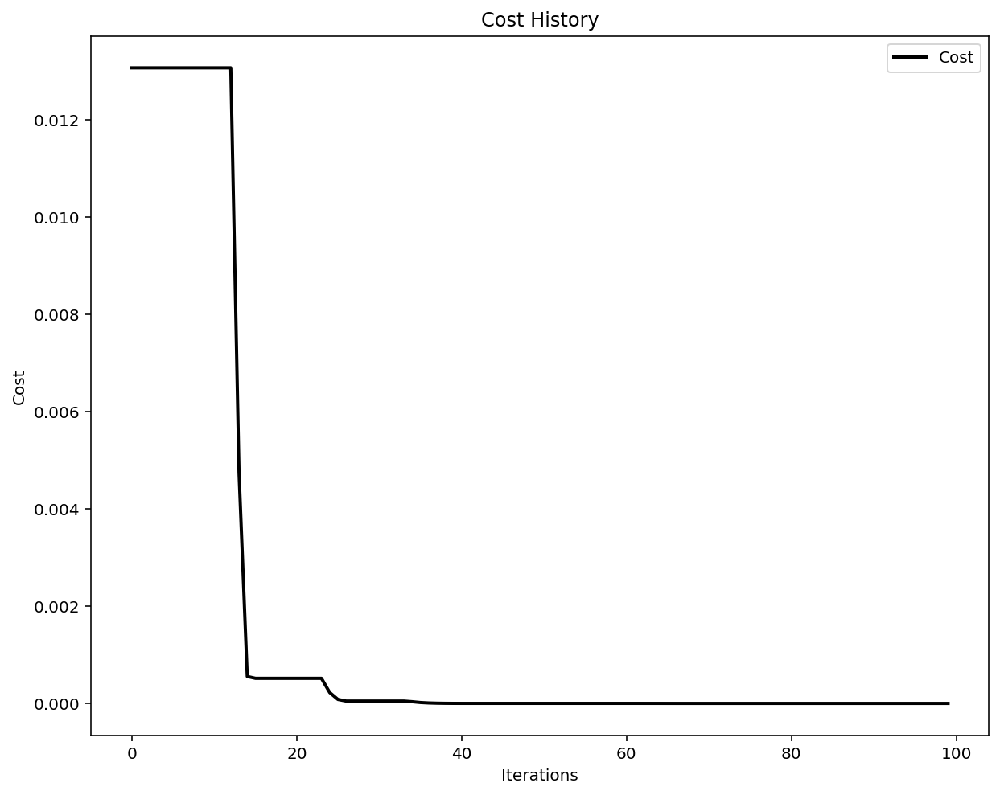

In [ ]:
plot_cost_history(cost_history=optimizer.cost_history)
plt.show()

In [ ]:
from pyswarms.utils.plotters.formatters import Mesher

In [ ]:
# Initialize mesher with sphere function
m = Mesher(func=fx.sphere)

In [ ]:
%%capture
# Make animation
animation = plot_contour(pos_history=optimizer.pos_history,mesher=m,mark=(0,0))

2022-10-27 14:19:07,092 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


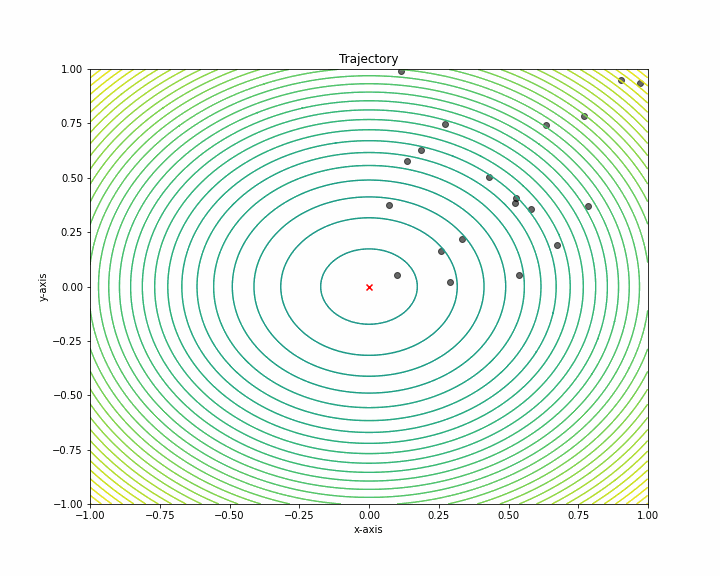

In [ ]:
# Enables us to view it in a Jupyter notebook
animation.save('result2D.gif', writer='pillow', fps=10)
Image(open('result2D.gif','rb').read())

### A 3D Animation

In [ ]:
# Obtain a position-fitness matrix using the Mesher.compute_history_3d()
# method. It requires a cost history obtainable from the optimizer class
pos_history_3d = m.compute_history_3d(optimizer.pos_history)

In [ ]:
# Make a designer and set the x,y,z limits to (-1,1), (-1,1) and (-0.1,1) respectively
from pyswarms.utils.plotters.formatters import Designer
d = Designer(limits=[(-1,1), (-1,1), (-0.1,1)], label=['x-axis', 'y-axis', 'z-axis'])

In [ ]:
%%capture
# Make animation
animation3d = plot_surface(pos_history=pos_history_3d, # Use the cost_history we computed
                           mesher=m, designer=d,       # Customizations
                           mark=(0,0,0))

2022-03-30 12:27:39,093 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


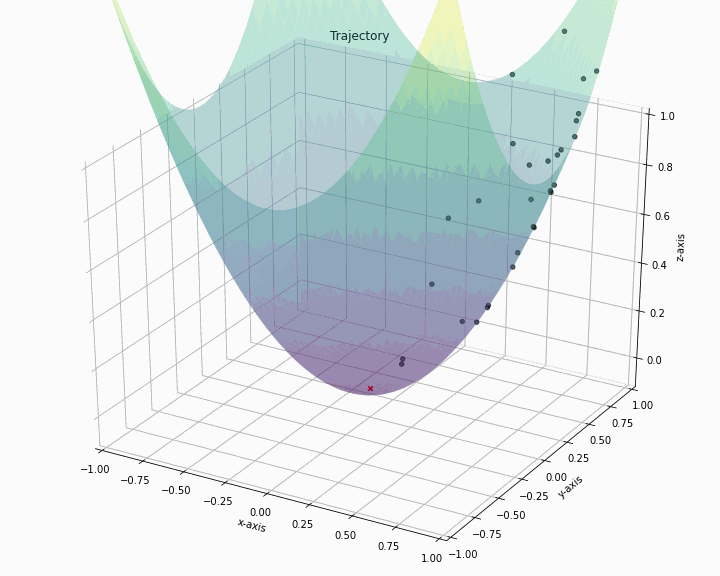

In [ ]:
animation3d.save('result3D.gif', writer='pillow', fps=10)
Image(open('result3D.gif','rb').read())

##<font color='navy' size=6pt> Simulated Annealing</font>

**Main Idea**: drop a random trial point and then, based on the value of the objective function, continue to drop other points at a certain distance. The distance between consecutive points is measured as a function of the "temperature" which is decreasing based on an exponential law.

**Important** This method use only one point at a time. The temperature of the grid is deacreasing, such as $T_{i+1}=rT_{i}$ where $0<r<1.$ The probability that the system will transition from state $e_i$ to state $e_{i+1}$ is

$$\text{P}(e_{i+1}\text{at temperature } T_i)=\begin{cases} e^{-(\text{New Loss} - \text{Loss})/T_i} &\text{if}& \text{New Loss}\, > \,\text{Loss}\\
1 &\text{if}& \text{New Loss}\, \leq \,\text{Loss}\end{cases} $$

Decision to continue: if
$$ \text{P}(e_{i+1}\text{at temperature } T_i)>\chi\,\, \text{where}\,\, \chi \sim \text{Unif}(0,1).$$

Formal steps:

- Let $s=s_0$ where $s_0$ is a random guess.
- An iterator $k$ is decreasing from $k_{max}$ to $0.$
- Set $T←\text{temperature}((k+1)/k_{max})$
- Pick a random neighbor, $s_{new}←\text{neighbor}(s)$
- If $\text{P}(s_{new},T)>\text{random}(0,1)$ then $s→s_{new}$
Output: the final state $s$



Visual example for simulated annealing algorithm: https://www.youtube.com/watch?v=iaq_Fpr4KZc

## <font color='navy' size = 6pt> Examples with Simulated Annealing

In [ ]:
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline, make_pipeline
plt.rc('font', size=16)
plt.rc('axes', titlesize=16)

In [ ]:
data = pd.read_csv('drive/MyDrive/Data Sets/housing.csv')

In [ ]:
data

,town,tract,longitude,latitude,crime,residential,industrial,river,nox,rooms,older,distance,highway,tax,ptratio,lstat,cmedv
0,Nahant,2011,-70.955002,42.255001,0.00632,18.0,2.31,no,0.538,6.575,65.199997,4.0900,1,296,15.300000,4.98,24.000000
1,Swampscott,2021,-70.949997,42.287498,0.02731,0.0,7.07,no,0.469,6.421,78.900002,4.9671,2,242,17.799999,9.14,21.600000
2,Swampscott,2022,-70.935997,42.283001,0.02729,0.0,7.07,no,0.469,7.185,61.099998,4.9671,2,242,17.799999,4.03,34.700001
3,Marblehead,2031,-70.928001,42.292999,0.03237,0.0,2.18,no,0.458,6.998,45.799999,6.0622,3,222,18.700001,2.94,33.400002
4,Marblehead,2032,-70.921997,42.298000,0.06905,0.0,2.18,no,0.458,7.147,54.200001,6.0622,3,222,18.700001,5.33,36.200001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,Winthrop,1801,-70.986000,42.231201,0.06263,0.0,11.93,no,0.573,6.593,69.099998,2.4786,1,273,21.000000,9.67,22.400000
502,Winthrop,1802,-70.990997,42.227501,0.04527,0.0,11.93,no,0.573,6.120,76.699997,2.2875,1,273,21.000000,9.08,20.600000
503,Winthrop,1803,-70.994797,42.226002,0.06076,0.0,11.93,no,0.573,6.976,91.000000,2.1675,1,273,21.000000,5.64,23.900000
504,Winthrop,1804,-70.987503,42.223999,0.10959,0.0,11.93,no,0.573,6.794,89.300003,2.3889,1,273,21.000000,6.48,22.000000


In [ ]:
data.drop('river',axis=1)

,town,tract,longitude,latitude,crime,residential,industrial,nox,rooms,older,distance,highway,tax,ptratio,lstat,cmedv
0,Nahant,2011,-70.955002,42.255001,0.00632,18.0,2.31,0.538,6.575,65.199997,4.0900,1,296,15.300000,4.98,24.000000
1,Swampscott,2021,-70.949997,42.287498,0.02731,0.0,7.07,0.469,6.421,78.900002,4.9671,2,242,17.799999,9.14,21.600000
2,Swampscott,2022,-70.935997,42.283001,0.02729,0.0,7.07,0.469,7.185,61.099998,4.9671,2,242,17.799999,4.03,34.700001
3,Marblehead,2031,-70.928001,42.292999,0.03237,0.0,2.18,0.458,6.998,45.799999,6.0622,3,222,18.700001,2.94,33.400002
4,Marblehead,2032,-70.921997,42.298000,0.06905,0.0,2.18,0.458,7.147,54.200001,6.0622,3,222,18.700001,5.33,36.200001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,Winthrop,1801,-70.986000,42.231201,0.06263,0.0,11.93,0.573,6.593,69.099998,2.4786,1,273,21.000000,9.67,22.400000
502,Winthrop,1802,-70.990997,42.227501,0.04527,0.0,11.93,0.573,6.120,76.699997,2.2875,1,273,21.000000,9.08,20.600000
503,Winthrop,1803,-70.994797,42.226002,0.06076,0.0,11.93,0.573,6.976,91.000000,2.1675,1,273,21.000000,5.64,23.900000
504,Winthrop,1804,-70.987503,42.223999,0.10959,0.0,11.93,0.573,6.794,89.300003,2.3889,1,273,21.000000,6.48,22.000000


In [ ]:
x = data.drop('river',axis=1).loc[:,'crime':'lstat'].values
y = data['cmedv'].values

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
mypipe = Pipeline(steps=[('scale',StandardScaler()),('lasso',Lasso(max_iter=10000))])

In [ ]:
%%time
params = {'lasso__alpha':np.linspace(0.001,2,num=4000)}
gs = GridSearchCV(estimator=mypipe,cv=10,scoring='neg_mean_squared_error',param_grid=params)
gs_results = gs.fit(x,y)
print(gs_results.best_params_)
print('The external validity is: ', np.abs(gs_results.best_score_))

{'lasso__alpha': 0.0949764941235309}
The external validity is:  33.474901655901235
CPU times: user 1min 48s, sys: 301 ms, total: 1min 49s
Wall time: 1min 54s


In [ ]:
%%time
model = ElasticNet(max_iter=10000)
params = [{'alpha':np.linspace(0.001,2,num=1000),'l1_ratio':np.linspace(0.001,1,num=1000)}]
gs = GridSearchCV(estimator=model,cv=10,scoring='neg_mean_squared_error',param_grid=params)
gs_results = gs.fit(x,y)
print(gs_results.best_params_)
print('The mean square error is: ', np.abs(gs_results.best_score_))

In [ ]:
print(gs_results.best_params_)
print('The mean square error is: ', np.abs(gs_results.best_score_))

{'alpha': 1.0, 'l1_ratio': 0.0}
The mean square error is:  64.57677655644844


In [ ]:
gs_results

In [ ]:
scale = StandardScaler()

In [ ]:
pipe = Pipeline([['Scale',scale],['Model',model]])

## Algorithm Implementation

In [10]:

# Objective function for n-dimensional grid
def objective_function_nd(x):
    # Example objective function; replace with your specific function
    return sum(xi**2 for xi in x)

# Generate a random candidate solution near the current solution for n dimensions
def get_candidate_solution_nd(current_solution, bounds,temp):
    return [xi + np.random.normal() * (bounds[i][1] - bounds[i][0]) * temp for i, xi in enumerate(current_solution)]

# Simulated Annealing algorithm for n dimensions with different bounds
def simulated_annealing_nd(objective, bounds, max_iterations, initial_temp, cooling_rate, dimensions):
    # Initialize with a random solution within the specific bounds for each dimension
    current_solution = [np.random.uniform(bounds[i][0], bounds[i][1]) for i in range(dimensions)]
    current_solution_cost = objective(current_solution)
    best_solution = current_solution[:]
    best_solution_cost = current_solution_cost

    # Current temperature
    temp = initial_temp

    for iteration in range(max_iterations):
        # Get a candidate solution respecting individual dimension bounds
        candidate_solution = get_candidate_solution_nd(current_solution, bounds,temp)
        candidate_solution_cost = objective(candidate_solution)

        # Check if the candidate solution is better
        if candidate_solution_cost < current_solution_cost:
            current_solution, current_solution_cost = candidate_solution, candidate_solution_cost
            if candidate_solution_cost < best_solution_cost:
                best_solution, best_solution_cost = candidate_solution, candidate_solution_cost
        else:
            # Accept worse solutions with a certain probability
            if np.random.uniform(0, 1) < np.exp((current_solution_cost - candidate_solution_cost) / temp):
                current_solution, current_solution_cost = candidate_solution, candidate_solution_cost

        # Decrease the temperature
        temp *= cooling_rate

        # Optional: Output some information
        if (iteration+1) % 500 == 0:
            print(f"Iteration {iteration+1}, Temperature: {temp:.2f}, Current Solution: {current_solution}, Current Cost: {current_solution_cost}")

    return best_solution, best_solution_cost


# Define parameters
bounds = [(-10, 10), (-20, 20), (-5, 5)]  # Individual bounds for each dimension
dimensions = len(bounds)  # Number of dimensions based on bounds
max_iterations = 2500  # Maximum number of iterations
initial_temp = 100  # Initial temperature
cooling_rate = 0.99  # Cooling rate

# Run the algorithm for n dimensions with different bounds
best_solution_nd, best_solution_cost_nd = simulated_annealing_nd(
    objective_function_nd, bounds, max_iterations, initial_temp, cooling_rate, dimensions
)
print(f"Best solution in {dimensions}D with different bounds: {best_solution_nd}, Best cost: {best_solution_cost_nd}")

Iteration 500, Temperature: 0.66, Current Solution: [-0.6467746013763991, -0.5722016533833019, 3.5958283257806163], Current Cost: 13.675713465606414
Iteration 1000, Temperature: 0.00, Current Solution: [0.06698841245533796, 0.0005612299960743861, -0.04201125615981627], Current Cost: 0.006252708026520671
Iteration 1500, Temperature: 0.00, Current Solution: [3.249392386636198e-05, -0.0038168182293457746, -0.00918171800833585], Current Cost: 9.887310283555329e-05
Iteration 2000, Temperature: 0.00, Current Solution: [0.0027311666938597844, 0.0002304534040074683, -0.00895049147933583], Current Cost: 8.76236780027309e-05
Iteration 2500, Temperature: 0.00, Current Solution: [0.0027296619505817812, 0.00023981658104338372, -0.008923849599198263], Current Cost: 8.714365802610827e-05
Best solution in 3D with different bounds: [0.0020187128118111285, -0.0019144569916283065, -0.00176699412794096], Best cost: 1.086261523754273e-05


## Particle Swarm Optimization with Lévy Flights

References:

*   https://arxiv.org/abs/1408.5316
*   https://github.com/ujjwalkhandelwal/cso_cuckoo_search_optimization

Visualization of Lévy Flights: 

*   https://openprocessing.org/sketch/660259/
*   https://www.youtube.com/watch?v=G1dM_rTfMP4


In [ ]:
class CSO:

    def __init__(self, fitness, P=50, n=2, pa=0.25, beta=1.5, bound=None,
                plot=False, min=True, verbose=False, Tmax=400):

        '''

        PARAMETERS:

        fitness: A FUNCTION WHICH EVALUATES COST (OR THE FITNESS) VALUE

        P: POPULATION SIZE

        n: TOTAL DIMENSIONS

        pa: ASSIGNED PROBABILITY

        beta: LEVY PARAMETER

        bound: AXIS BOUND FOR EACH DIMENSION

        X: PARTICLE POSITION OF SHAPE (P,n)

        ################ EXAMPLE #####################

        If ith egg Xi = [x,y,z], n = 3, and if
        bound = [(-5,5),(-1,1),(0,5)]
        Then, x∈(-5,5); y∈(-1,1); z∈(0,5)

        ##############################################

        Tmax: MAXIMUM ITERATION

        best: GLOBAL BEST POSITION OF SHAPE (n,1)

        '''
        self.fitness = fitness
        self.P = P
        self.n = n
        self.Tmax = Tmax
        self.pa = pa
        self.beta = beta
        self.bound = bound
        self.plot = plot
        self.min = min
        self.verbose = verbose

        # X = (U-L)*rand + L (U AND L ARE UPPER AND LOWER BOUND OF X)
        # U AND L VARY BASED ON THE DIFFERENT DIMENSION OF X

        self.X = []

        if bound is not None:
            for (U, L) in bound:
                x = (U-L)*np.random.rand(P,) + L
                self.X.append(x)
            self.X = np.array(self.X).T
        else:
            self.X = np.random.randn(P,n)

    def update_position_1(self):

        '''

        ACTION:

        TO CALCULATE THE CHANGE OF POSITION 'X = X + rand*C' USING LEVY FLIGHT METHOD

        C = 0.01*S*(X-best) WHERE S IS THE RANDOM STEP, and β = beta (TAKEN FROM [1])

              u
        S = -----
                1/β
             |v|

        beta = 1.5

        u ~ N(0,σu) # NORMAL DISTRIBUTION WITH ZERO MEAN AND 'σu' STANDARD DEVIATION

        v ~ N(0,σv) # NORMAL DISTRIBUTION WITH ZERO MEAN AND 'σv' STANDARD DEVIATION

        σv = 1

                     Γ(1+β)*sin(πβ/2)
        σu^β = --------------------------
                   Γ((1+β)/2)*β*(2^((β-1)/2))

        Γ IS THE GAMMA FUNCTION

        '''

        num = gamma(1+self.beta)*np.sin(np.pi*self.beta/2)
        den = gamma((1+self.beta)/2)*self.beta*(2**((self.beta-1)/2))
        σu = (num/den)**(1/self.beta)
        σv = 1
        u = np.random.normal(0, σu, self.n)
        v = np.random.normal(0, σv, self.n)
        S = u/(np.abs(v)**(1/self.beta))

        # DEFINING GLOBAL BEST SOLUTION BASED ON FITNESS VALUE

        for i in range(self.P):
            if i==0:
                self.best = self.X[i,:].copy()
            else:
                self.best = self.optimum(self.best, self.X[i,:])

        Xnew = self.X.copy()
        for i in range(self.P):
            Xnew[i,:] += np.random.randn(self.n)*0.01*S*(Xnew[i,:]-self.best)
            self.X[i,:] = self.optimum(Xnew[i,:], self.X[i,:])

    def update_position_2(self):

        '''

        ACTION:

        TO REPLACE SOME NEST WITH NEW SOLUTIONS

        HOST BIRD CAN THROW EGG AWAY (ABANDON THE NEST) WITH FRACTION

        pa ∈ [0,1] (ALSO CALLED ASSIGNED PROBABILITY) AND BUILD A COMPLETELY

        NEW NEST. FIRST WE CHOOSE A RANDOM NUMBER r ∈ [0,1] AND IF r < pa,

        THEN 'X' IS SELECTED AND MODIFIED ELSE IT IS KEPT AS IT IS.

        '''

        Xnew = self.X.copy()
        Xold = self.X.copy()
        for i in range(self.P):
            d1,d2 = np.random.randint(0,5,2)
            for j in range(self.n):
                r = np.random.rand()
                if r < self.pa:
                    Xnew[i,j] += np.random.rand()*(Xold[d1,j]-Xold[d2,j])
            self.X[i,:] = self.optimum(Xnew[i,:], self.X[i,:])

    def optimum(self, best, particle_x):

        '''

        PARAMETERS:

        best: GLOBAL BEST SOLUTION 'best'

        particle_x: PARTICLE POSITION

        ACTION:

        COMPARE PARTICLE'S CURRENT POSITION WITH GLOBAL BEST POSITION

            1. IF PROBLEM IS MINIMIZATION (min=TRUE), THEN CHECKS WHETHER FITNESS VALUE OF 'best'

            IS LESS THAN THE FITNESS VALUE OF 'particle_x' AND IF IT IS GREATER, THEN IT

            SUBSTITUTES THE CURRENT PARTICLE POSITION AS THE BEST (GLOBAL) SOLUTION

            2. IF PROBLEM IS MAXIMIZATION (min=FALSE), THEN CHECKS WHETHER FITNESS VALUE OF 'best'

            IS GREATER THAN THE FITNESS VALUE OF 'particle_x' AND IF IT IS LESS, THEN IT

            SUBSTITUTES THE CURRENT PARTICLE POSITION AS THE BEST (GLOBAL) SOLUTION

        '''
        if self.min:
            if self.fitness(best) > self.fitness(particle_x):
                best = particle_x.copy()
        else:
            if self.fitness(best) < self.fitness(particle_x):
                best = particle_x.copy()
        return best

    def clip_X(self):

        # IF BOUND IS SPECIFIED THEN CLIP 'X' VALUES SO THAT THEY ARE IN THE SPECIFIED RANGE

        if self.bound is not None:
            for i in range(self.n):
                xmin, xmax = self.bound[i]
                self.X[:,i] = np.clip(self.X[:,i], xmin, xmax)

    def execute(self):

        '''

        PARAMETERS:

        t: ITERATION NUMBER

        fitness_time: LIST STORING FITNESS (OR COST) VALUE FOR EACH ITERATION

        time: LIST STORING ITERATION NUMBER ([0,1,2,...])

        ACTION:

        AS THE NAME SUGGESTS, THIS FUNCTION EXECUTES CUCKOO SEARCH ALGORITHM

        BASED ON THE TYPE OF PROBLEM (MAXIMIZATION OR MINIMIZATION).

        NOTE: THIS FUNCTION PRINTS THE GLOBAL FITNESS VALUE FOR EACH ITERATION

        IF THE VERBOSE IS TRUE

        '''

        self.fitness_time, self.time = [], []

        for t in range(self.Tmax):
            self.update_position_1()
            self.clip_X()
            self.update_position_2()
            self.clip_X()
            self.fitness_time.append(self.fitness(self.best))
            self.time.append(t)
            if self.verbose:
                print('Iteration:  ',t,'| best global fitness (cost):',round(self.fitness(self.best),7))

        print('\nOPTIMUM SOLUTION\n  >', np.round(self.best.reshape(-1),7).tolist())
        print('\nOPTIMUM FITNESS\n  >', np.round(self.fitness(self.best),7))
        print()
        if self.plot:
            self.Fplot()

    def Fplot(self):

        # PLOTS GLOBAL FITNESS (OR COST) VALUE VS ITERATION GRAPH

        plt.plot(self.time, self.fitness_time)
        plt.title('Fitness value vs Iteration')
        plt.xlabel('Iteration')
        plt.ylabel('Fitness value')
        plt.show()

In [ ]:
def fitness(X):

    '''

    X: POSITION (EITHER CURRENT, LOCAL BEST OR GLOBAL BEST) OF SIZE (n,)

    2-DIMENSIONAL VECTORS (X = (x,y))

    #################################################################################

    HIMMELBLAU'S FUNCTION

    MINIMIZE f(x) = (x^2 + y - 11)^2 + (x + y^2 - 7)^2

    OPTIMUM SOLUTION IS x* = 3 AND y* = 2

    REPLACE 'f' BELOW WITH THIS TO TEST EXAMPLE-1

    f = (x**2 + y - 11)**2 + (x + y**2 - 7)**2

    '''
    X = np.array(X).reshape(-1,1)
    x, y = X[0][0], X[1][0]
    f = (x**2 + y - 11)**2 + (x + y**2 - 7)**2
    return f

In [ ]:
CSO(fitness=fitness, n=2,P=10,bound=[(-6,6),(-6,6)],Tmax=1000,plot=True).execute()